### READ-ME:

This notebook is used to analyze the randomness experiments using BinaryMI on the adult dataset. For other models/datasets you may need some modifications.

This notebook is expecting data generated by randomness.py.
In details it uses for gamma 0.0 to 1.0 the results_{gamma}.csv files, which contain the index of the individuals corresponding to the index in the adult.data file, the mean of the predictions and S.

Example:

|index|mean_prediction|S|
|---|---|---|
|14160|1.0|0|
|27048|0.453|0|
|28868|0.299|1|
|5667|1.0|0|
|7827|1.0|1|
|...| ...| ...|

The index is used to merge the data with the other features of the individual.
(Maybe it would be smarter to include that into the file from the beginning, but it is what it is :D)

The two main functions of the notebook is
(i) to compare the race and age distribution between all data and the data with high uncertainty,
(ii) to get the weights of the features to see its influence on the entropy.

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from src.combined_project.pipelines.preprocess_data.nodes import split_into_X_y_S
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold
import random
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import PCA
from itertools import product
import matplotlib.gridspec as gridspec

In [7]:
LOADPATH = "randomness_05-11-2024_09-37-51" # path the the folder containing the data
SAVEPATH = "adult_binarymi" # path where plots will be saved

In [8]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)

In [9]:
def entropy(p):
    if p == 0.0 or p == 1.0:
        return 0
    return -p*np.log2(p) - (1-p)*np.log2(1-p)

# get data (just X) similiar like in randomness.py for given indices
def get_data_adult(test_index):
    data = pd.read_csv('../data/01_raw/adult.data',sep=',')
    dataset = {"data": "adult_data"
      ,"label": 'income'
      ,"sep": ','
      ,"pos_label": ' <=50K'
      ,"neg_label": ' >50K'
      ,"privileged_sens_attr": ' Male'
      ,"unprivileged_sens_attr": ' Female'
      ,"filter": False
      ,"sensitive_attributes":['sex']
      ,"discard_features": [None]
      ,"categorial_features":['workclass','education','marital-status','occupation','relationship','native-country','race']
      ,"continuous_features":['age','fnlwgt','education-num','capital-gain','capital-loss','hours-per-week']}

    X, y, S, name, sens_attrs, cont, label = split_into_X_y_S(data,dataset)
    
    y = y.to_numpy()
    S = S.to_numpy()
    
    train_index = X.index.difference(test_index)
    
    X_train = X.loc[train_index]
    X_test = X.loc[test_index]

    #scaler = StandardScaler()
    #X_train[cont] = scaler.fit_transform(X_train[cont])
    #X_test[cont] = scaler.transform(X_test[cont])

    X_train = X_train#.to_numpy()
    X_test = X_test#.to_numpy()
    
    return X_train, X_test

In [10]:
# first look at the data
for gamma in np.linspace(0,1,11):
    res = pd.read_csv(f"{LOADPATH}/results_{round(gamma,1)}.csv")
    print(res["mean_prediction"].describe())

count    10876.000000
mean         0.806942
std          0.292631
min          0.224000
25%          0.549500
50%          1.000000
75%          1.000000
max          1.000000
Name: mean_prediction, dtype: float64
count    10876.000000
mean         0.788203
std          0.330054
min          0.120000
25%          0.538000
50%          1.000000
75%          1.000000
max          1.000000
Name: mean_prediction, dtype: float64
count    10876.000000
mean         0.842751
std          0.259983
min          0.244000
25%          0.744000
50%          1.000000
75%          1.000000
max          1.000000
Name: mean_prediction, dtype: float64
count    10876.0
mean         1.0
std          0.0
min          1.0
25%          1.0
50%          1.0
75%          1.0
max          1.0
Name: mean_prediction, dtype: float64
count    10876.000000
mean         0.996709
std          0.007693
min          0.950000
25%          1.000000
50%          1.000000
75%          1.000000
max          1.000000
Name: me

In [11]:
def percentile(df, q,column_name):
    return df[column_name].quantile(q)

def get_percentile(gamma,q,S=None):
    df = pd.read_csv(f"{LOADPATH}/results_{gamma}.csv")
    _, X = get_data_adult(df.index)
    combined_df = pd.concat([df, X], axis=1) # Merge the data
    combined_df["entropy"] = combined_df["mean_prediction"].apply(entropy) # calculate entropy
    if S is not None: # filter by S
        combined_df = combined_df[combined_df["S"] == S] 
    perc = percentile(combined_df, q, "entropy")
    return combined_df[combined_df["entropy"] > perc] # filter by quantile

In [12]:
def get_data_by_threshold(gamma,threshold, S=None):
    df = pd.read_csv(f"{LOADPATH}/results_{gamma}.csv")
    _, X = get_data_adult(df.index)
    combined_df = pd.concat([df, X], axis=1) # Merge the data
    combined_df["entropy"] = combined_df["mean_prediction"].apply(entropy) # calculate entropy
    if S is not None:
        combined_df = combined_df[combined_df["S"] == S]
    return combined_df[combined_df["entropy"] >= threshold] # filter by given threshold

In [13]:
# make plots either by quantile or threshold, filter by S
def plot_distribution_age_race(quantile=0.9,threshold=None,S=None):
    df = pd.read_csv(f"{LOADPATH}/results_{0.0}.csv")
    _, X = get_data_adult(df.index)
    
    X = pd.concat([df, X], axis=1)
    if S is not None: 
        X = X[X["S"] == S]

    gammas = np.linspace(0,1,11)
    fig, ax = plt.subplots(len(gammas),2, figsize=(20,40))

    races = ["race_ Amer-Indian-Eskimo"
    ,"race_ Asian-Pac-Islander"
    ,"race_ Black"
    ,"race_ Other"
    ,"race_ White"]
    
    if threshold is not None and quantile is not None:
        raise ValueError("Only one of threshold or quantile can be set")
    if threshold is None and quantile is None:
        raise ValueError("One of threshold or quantile must be set")

    for i,gamma in enumerate(gammas):
        gamma = round(gamma,1)
        if threshold is not None:
            data = get_data_by_threshold(gamma=gamma,threshold=threshold,S=S)
        elif quantile is not None:
            data = get_percentile(gamma=gamma, q=quantile,S=S)
        if data.shape[0] == 0: # Check for empty dataset
            ax[i,0].set_title(f"Gamma: {gamma}")
            continue
        
        # plot age distrubutions
        bins = np.linspace(min(X["age"].min(), data["age"].min()), max(X["age"].max(), data["age"].max()), 20)
        ax[i,0].hist(data["age"],bins=bins,edgecolor="black",color="skyblue",density=True,label="Individuals with high uncertainty")
        ax[i,0].hist(X["age"],bins=bins,edgecolor="red",color="red",histtype="step",density=True,label="All individuals")
        ax[i,0].set_title(f"Gamma: {gamma}")
        ax[i,0].set_ylabel("Density")

        # Count occurance of races
        size_percentile_data = data.shape[0]
        size_all_data = X.shape[0]

        count_all_data = []
        count_percentile_data = []

        for race in races:
            count_percentile_data.append(data[data[race]].shape[0]/size_percentile_data)
            count_all_data.append(X[X[race]].shape[0]/size_all_data)

        # plot race
        ax[i,1].bar(range(5),height=count_percentile_data,color="skyblue",label="Individuals with high uncertainty")
        bars = ax[i,1].bar(range(5),height=count_all_data,edgecolor="red",label="All individuals")
        for bar in bars:
            bar.set_facecolor('none')
        ax[i,1].set_ylabel("Percentage")
        ax[i,1].set_xticks(range(5),["Amer-Indian-Eskimo","Asian-Pac-Islander","Black","Other","White"])
    ax[0,0].legend(loc="upper right")
    ax[0,1].legend(loc="upper left")
    ax[i,0].set_xlabel("Age")
    ax[i,1].set_xlabel("Race")
    if threshold is not None:
        fig.suptitle(f"Distribution of age and race for individuals with high uncertainty (entropy >= {threshold}) compared to all individuals (S={S})")
        plt.savefig(f"{SAVEPATH}/trsh_{threshold}_S{S}.png")  
    elif quantile is not None:
        fig.suptitle(f"Distribution of age and race for individuals with high uncertainty ({quantile}-quantile) compared to all individuals (S={S})")
        plt.savefig(f"{SAVEPATH}/quant_{quantile}_S{S}.png")  

    
    
    

In [14]:
def test_performance(model,X,y):
    kf = KFold(n_splits=5, random_state=None, shuffle=False)
    mse = np.zeros(5)
    for i, (train_index, test_index) in enumerate(kf.split(X)):
        model.fit(X.iloc[train_index],y.iloc[train_index])
        y_pred = model.predict(X.iloc[test_index])
        mse[i] = mean_squared_error(y.iloc[test_index],y_pred)
    return mse

In [15]:
# get feature weights either by quantile or threshold, filter by S
def get_feature_weights(gamma,S=None,aggr=False):
    
    #get and preprocess data
    df = pd.read_csv(f"{LOADPATH}/results_{gamma}.csv")
    _, data = get_data_adult(df.index)
    
    data = pd.concat([df, data], axis=1)
    if S is not None: 
        data = data[data["S"] == S]
    
    data["entropy"] = data["mean_prediction"].apply(entropy)
    
    y = data["entropy"] 
    X = data.drop(columns=["index","mean_prediction","entropy"],inplace=False)
    
    # fit linreg
    linreg = LinearRegression()
    mse = test_performance(linreg,X,y)
    linreg.fit(X,y)
    
    if not aggr:
        return pd.DataFrame({"feature":X.columns,"weight":linreg.coef_}), mse.mean()
    else:
        cols = list(X.columns[0:7]) + ["workclass","marital-status","occupation","relationship","native_country","race"]
        # indices of the features after one-hot-encoding
        workclass = range(7,32)
        marital_status = range(32,39)
        occupation = range(39,54)
        relationship = range(54,60)
        native_country = range(60,102)
        race = range(102,107)

        # get the absolute coefficients of the linreg
        abs_coefs = np.zeros(13)
        abs_coefs[0:7] = np.abs(linreg.coef_[0:7])
        abs_coefs[7] = np.abs(linreg.coef_[workclass]).sum()
        abs_coefs[8] = np.abs(linreg.coef_[marital_status]).sum()
        abs_coefs[9] = np.abs(linreg.coef_[occupation]).sum()
        abs_coefs[10] = np.abs(linreg.coef_[relationship]).sum()
        abs_coefs[11] = np.abs(linreg.coef_[native_country]).sum()
        abs_coefs[12] = np.abs(linreg.coef_[race]).sum()
        
        # max coefficient for each feature
        max_coefs = np.zeros(13)
        max_coefs[0:7] = np.abs(linreg.coef_[0:7])
        argmax = np.argmax(np.abs(linreg.coef_[workclass]))
        max_coefs[7] = linreg.coef_[argmax]
        argmax = np.argmax(np.abs(linreg.coef_[marital_status]))
        max_coefs[8] = linreg.coef_[argmax]
        argmax = np.argmax(np.abs(linreg.coef_[occupation]))
        max_coefs[9] = linreg.coef_[argmax]
        argmax = np.argmax(np.abs(linreg.coef_[relationship]))
        max_coefs[10] = linreg.coef_[argmax]
        argmax = np.argmax(np.abs(linreg.coef_[native_country]))
        max_coefs[11] = linreg.coef_[argmax]
        argmax = np.argmax(np.abs(linreg.coef_[race]))
        max_coefs[12] = linreg.coef_[argmax]
        
        # mean of coefficients for each feature
        mean_coefs = np.zeros(13)
        mean_coefs[0:7] = (linreg.coef_[0:7])
        mean_coefs[7] = np.mean((linreg.coef_[workclass]))
        mean_coefs[8] = np.mean((linreg.coef_[marital_status]))
        mean_coefs[9] = np.mean((linreg.coef_[occupation]))
        mean_coefs[10] = np.mean((linreg.coef_[relationship]))
        mean_coefs[11] = np.mean((linreg.coef_[native_country]))
        mean_coefs[12] = np.mean((linreg.coef_[race]))

        # get the coefficients of the linreg
        coefs = np.zeros(13)
        coefs[0:7] = linreg.coef_[0:7]
        coefs[7] = linreg.coef_[workclass].sum()
        coefs[8] = linreg.coef_[marital_status].sum()
        coefs[9] = linreg.coef_[occupation].sum()
        coefs[10] = linreg.coef_[relationship].sum()
        coefs[11] = linreg.coef_[native_country].sum()
        coefs[12] = linreg.coef_[race].sum()
        return pd.DataFrame({"feature":cols,"weight(abs)":abs_coefs,"max weight":max_coefs,"mean weight":mean_coefs,"weight":coefs}), mse.mean()
    
    

In [16]:
# get the feature weights for all gammas and plots the tables (aggregated back to original features)
def table_feature_weights(S=None,aggr=False):   
    gammas = np.linspace(0,1,11)
    length = 40 if aggr else 300
    aggregated = "" if not aggr else "_aggr"
    fig, ax = plt.subplots(len(gammas),1, figsize=(10,length))
    for i,gamma in enumerate(gammas):
        gamma = round(gamma,1)
        df, mse_mean = get_feature_weights(gamma,S,aggr) # get the dataframes
        ax[i].axis('tight')
        ax[i].axis('off')
        if df is None:
            continue
        table = ax[i].table(cellText=df.values, colLabels=df.columns, cellLoc = 'center', loc='center')
        ax[i].set_title(f"Gamma: {gamma}| Models MSE: {mse_mean}")
        # set the style of the header
        for col in range(len(df.columns)):
            header_cell = table[0, col]  # Access header cells (row 0)
            header_cell.set_facecolor('lightgrey')  # Header background color
            header_cell.set_text_props(weight='bold', fontsize=12)  # Header text style
            header_cell.set_linewidth(2)  # Thicker border for header
        
        # Optionally save the data as csv-files (you need to create the folder csv in SAVEPATH)    
        #df.to_csv(f"{SAVEPATH}/csv/feature_weights_gamma{gamma}_S{S}{aggregated}.csv")
    fig.suptitle(f"Feature weights for predicting the entropy (S={S})")
    plt.savefig(f"{SAVEPATH}/feature_weights_S{S}{aggregated}.pdf",dpi=300)

In [17]:
def entropy_infos(gamma,S=None):
    df = pd.read_csv(f"{LOADPATH}/results_{gamma}.csv")
    _, X = get_data_adult(df.index)
    combined_df = pd.concat([df, X], axis=1) # Merge the data
    combined_df["entropy"] = combined_df["mean_prediction"].apply(entropy) # calculate entropy
    if S is not None:
        combined_df = combined_df[combined_df["S"] == S]
    mean = combined_df["entropy"].mean()
    max = combined_df["entropy"].max()
    min = combined_df["entropy"].min()
    std = combined_df["entropy"].std()
    return mean, std, max, min
    

In [41]:
def heatmap_feature_weights(features=None,S=None,fraction=False,suffix=""):
    gammas = np.linspace(0,1,11)
    #fig, ax = plt.subplots(2,1,layout="constrained",figsize=(10,30))
    # Create a figure
    fig = plt.figure(figsize=(10,30))

    gs = gridspec.GridSpec(6, 1)  
    ax1 = fig.add_subplot(gs[0:5, 0])  
    ax2 = fig.add_subplot(gs[5, 0]) 
    ax = [ax1,ax2]
    
    df, _ = get_feature_weights(0.0,S,aggr=False)
    data = np.zeros((df.shape[0],len(gammas)))
    ent_mean = np.zeros(len(gammas))
    ent_std = np.zeros(len(gammas))
    ent_max = np.zeros(len(gammas))
    ent_min = np.zeros(len(gammas))
    mse = np.zeros(len(gammas))
    for i,gamma in enumerate(gammas):
        gamma = round(gamma,1)
        df, mse[i] = get_feature_weights(gamma,S,aggr=False)
        data[:,i] = df["weight"]
        ent_mean[i], ent_std[i], ent_max[i], ent_min[i] = entropy_infos(gamma,S)
        if fraction:
            data[:,i] = data[:,i]/(ent_max[i]-ent_min[i])
    if features is not None:
        ind = df["feature"][df["feature"].isin(features)].index
        data = data[ind,:]
    else:
        ind = df["feature"].index
    im = ax[0].imshow(data)
    ax[0].set_xticks(range(len(gammas)),labels=[round(gamma,1) for gamma in gammas])
    ax[0].set_yticks(range(len(ind)),df["feature"][ind])
    ax[0].set_title("Feature coefficients for predicting the entropy with LinReg")
    ax[0].set_xlabel("Gamma")
    
    for i in range(len(gammas)):
        for j in range(data.shape[0]):
            if data[j,i] != 0.0:
                text = ax[0].text(i, j, round(data[j,i],2),ha="center", va="center", color="w",
                               fontsize=5,alpha=0.6)
    
    #fig.tight_layout()
    ax[0].set_aspect(aspect=0.5)
    plt.setp(ax[0].get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")
    
    infos = pd.DataFrame({"Gamma":[round(gamma,1) for gamma in gammas],"MSE":mse,"Entropy: Mean":ent_mean,"Std":ent_std,"Max":ent_max,"Min":ent_min})
    table = ax[1].table(cellText=infos.values, colLabels=infos.columns, cellLoc = 'center', loc='center')
    #ax[1].set_title("Entropy")
    ax[1].axis('tight')
    ax[1].axis('off')
    # set the style of the header
    for col in range(6):
        header_cell = table[0, col]  # Access header cells (row 0)
        header_cell.set_facecolor('lightgrey')  # Header background color
        header_cell.set_text_props(weight='bold', fontsize=12)  # Header text style
        header_cell.set_linewidth(2)  # Thicker border for header
    
    plt.colorbar(im)
    frac = "_frac" if fraction else ""
    plt.savefig(f"heatmap{frac}{suffix}.pdf")

### Experimenting with different quantiles and thresholds:

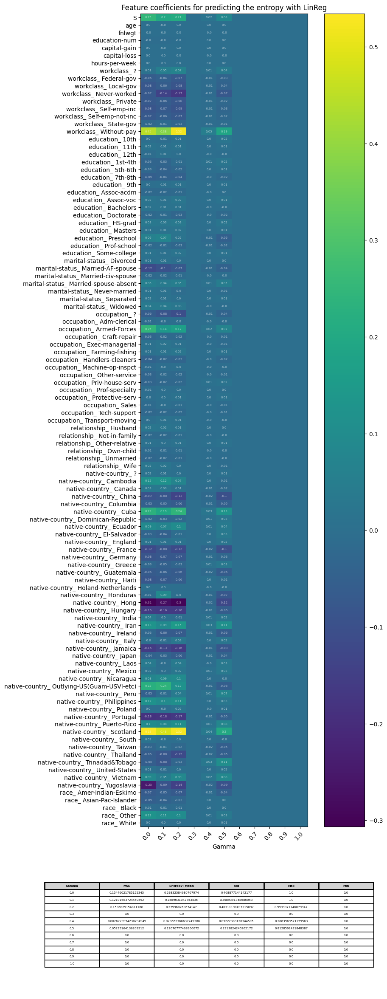

In [42]:
heatmap_feature_weights()

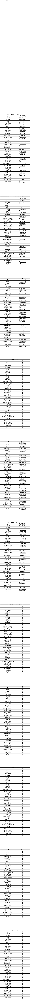

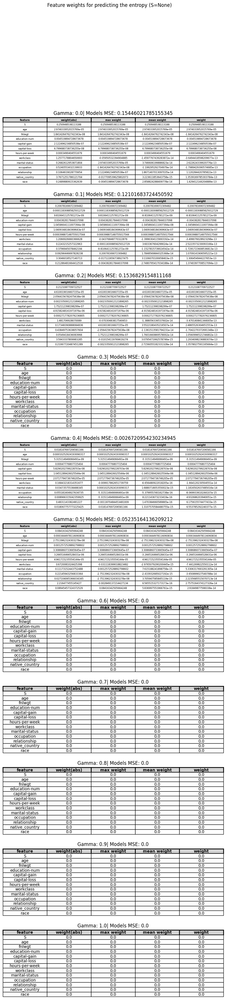

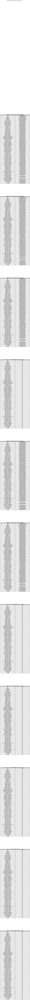

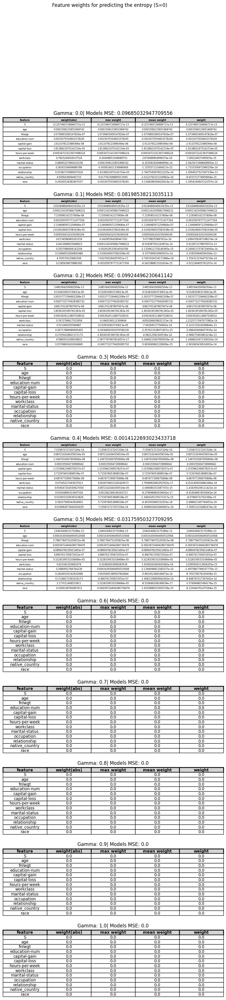

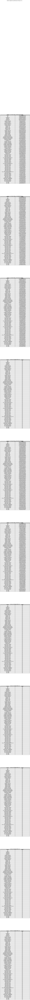

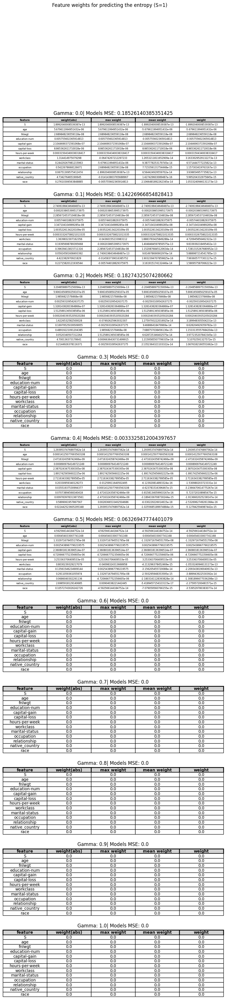

In [124]:
for S in [None,0,1]:
    table_feature_weights(S)
    table_feature_weights(S,aggr=True)

In [ ]:
Q = [0.95,0.75]
threshold = None
for q,S in product(Q,[None,1,0]):
    plot_distribution_age_race(q,threshold=None,S=S)


In [ ]:
q = None
thresholds = [0.8,0.7,0.5]
for threshold,S in product(thresholds,[None,1,0]):
    plot_distribution_age_race(q,threshold,S=S)

Just some experimental stuff:

In [ ]:
# PCA
data = get_percentile(gamma=0.1, q=0.9,S=None)
data.drop(columns=["index","mean_prediction","entropy","S"],inplace=True)
pca = PCA(n_components=2)
pca.fit(data)

In [ ]:
print(len(data.columns))
for col in data.columns:
    print(col)

In [ ]:
first_comp, second_comp = pca.components_

In [ ]:
abs_first_comp =  np.abs(first_comp)

In [ ]:
weights = np.zeros(13)
weights[0:6] = first_comp[0:6]

In [ ]:
workclass = range(6,31)
marital_status = range(31,38)
occupation = range(38,53)
relationship = range(53,59)
native_country = range(59,101)
race = range(101,106)


In [ ]:
weights[7] = first_comp[workclass].sum()
weights[8] = first_comp[marital_status].sum()
weights[9] = first_comp[occupation].sum()
weights[10] = first_comp[relationship].sum()
weights[11] = first_comp[native_country].sum()
weights[12] = first_comp[race].sum()

In [ ]:
weights

In [ ]:
weights_second = np.zeros(13)
weights_second[0:6] = second_comp[0:6]
weights_second[7] = second_comp[workclass].sum()
weights_second[8] = second_comp[marital_status].sum()
weights_second[9] = second_comp[occupation].sum()
weights_second[10] = second_comp[relationship].sum()
weights_second[11] = second_comp[native_country].sum()
weights_second[12] = second_comp[race].sum()

In [ ]:
weights_second

In [ ]:
data = get_percentile(gamma=0.1, q=0.9,S=None)
y = data["entropy"]
X = data.drop(columns=["index","mean_prediction","entropy","S"],inplace=False)

In [ ]:
X.columns

In [ ]:
linreg = LinearRegression()
linreg.fit(X,y)

In [ ]:
linreg.coef_

In [ ]:
workclass = range(6,31)
marital_status = range(31,38)
occupation = range(38,53)
relationship = range(53,59)
native_country = range(59,101)
race = range(101,106)
coefs = np.zeros(13)
coefs[0:6] = np.abs(linreg.coef_[0:6])
print(coefs)
coefs[7-1] = np.abs(linreg.coef_[workclass]).sum()
coefs[8-1] = np.abs(linreg.coef_[marital_status]).sum()
coefs[9-1] = np.abs(linreg.coef_[occupation]).sum()
coefs[10-1] = np.abs(linreg.coef_[relationship]).sum()
coefs[11-1] = np.abs(linreg.coef_[native_country]).sum()
coefs[12-1] = np.abs(linreg.coef_[race]).sum()

In [ ]:
linreg.coef_[0:6]

In [ ]:
table_feature_weights(0.9,None,S=None)

In [ ]:
get_feature_weights(gamma=0.1,quantile=0.9,threshold=None,S=None)

In [ ]:

cols = list(X.columns[0:6]) + ["workclass","marital-status","occupation","relationship","native_country","race"]
cols

In [ ]:
for col,coef in zip(cols,coefs):
    print(f"{col}: {coef}")

In [ ]:
coefs

In [ ]:
linreg.coef_[native_country]

In [ ]:
np.abs(linreg.coef_[race]).sum()

In [ ]:
def test_performance(model,X,y):
    kf = KFold(n_splits=5, random_state=None, shuffle=False)
    mse = np.zeros(5)
    for i, (train_index, test_index) in enumerate(kf.split(X)):
        model.fit(X.iloc[train_index],y.iloc[train_index])
        y_pred = model.predict(X.iloc[test_index])
        mse[i] = mean_squared_error(y.iloc[test_index],y_pred)
    return mse


#get and preprocess data
df = pd.read_csv(f"{LOADPATH}/results_{0.0}.csv")
_, data = get_data_adult(df.index)

data = pd.concat([df, data], axis=1)
if S is not None: 
    data = data[data["S"] == S]

data["entropy"] = data["mean_prediction"].apply(entropy)

y = data["entropy"] 
X = data.drop(columns=["index","mean_prediction","entropy"],inplace=False)

# fit linreg
linreg = LinearRegression()

print(test_performance(linreg,X,y))

linreg.fit(X,y)

In [ ]:
res